In [ ]:
! pip install NRCLex 
! pip install little_mallet_wrapper 
! pip install textblob 
! pip install wordcloud 
! pip install vaderSentiment 
! pip install spacy 
! pip install nltk 
! pip install sentence-transformers 
! pip install hdbscan 
! pip install bertopic 
! pip install transformers 
! pip install scipy
! pip install emot
! pip install emoji
! pip install snscrape
! pip install spacy_transformers

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 396.4/396.4 KB 8.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for NRCLex: filename=NRCLex-3.0.0-py3-none-any.whl size=43327 sha256=23789db4e9e3ca94b951381c0739dd6459249541fad36fed8762101ab80464a1
  Stored in directory: /root/.cache/pip/wheels/68/c4/f2/c390dd3eac398fdf45f7a01c6516bc53fa7a9ab59c7d2ff518
Successfully built NRCLex
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 126.0/126.0 KB 3.8 MB/s eta 0:00:00
Looking in indexes:

In [ ]:
import locale
import re

import emoji
import gensim
import gensim.corpora as corpora
import little_mallet_wrapper
import matplotlib.pyplot as plt
import nltk
import numpy as np
import os
import pandas as pd
import seaborn as sns
import snscrape.modules.twitter as sntwitter
import spacy
import spacy_transformers

from bertopic import BERTopic
from collections import Counter
from emot.emo_unicode import UNICODE_EMOJI
from emot.emo_unicode import EMOTICONS_EMO
from gensim.utils import simple_preprocess
from hdbscan import HDBSCAN
from nltk.corpus import wordnet
from nltk.stem import WordNetLemmatizer
from nltk.tokenize.treebank import TreebankWordDetokenizer
from nrclex import NRCLex
from PIL import Image
from scipy.special import softmax
from sentence_transformers import SentenceTransformer
from sklearn.feature_extraction.text import CountVectorizer
from spacy import displacy
from spacy.cli import download
from textblob import TextBlob
from tqdm import tqdm
from transformers import AutoTokenizer, AutoModelForSequenceClassification
from umap import UMAP
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
from wordcloud import WordCloud


def getpreferredencoding(do_setlocale = True):
    return "UTF-8" 
locale.getpreferredencoding = getpreferredencoding
sentence_model = SentenceTransformer("all-MiniLM-L6-v2")
download("en_core_web_trf")
spacy_nlp = spacy.load('en_core_web_trf')
nltk.download("popular")
pd.set_option('display.max_columns', None)
pd.options.mode.chained_assignment = None

/usr/local/lib/python3.9/dist-packages/torch/cuda/__init__.py:497: UserWarning: Can't initialize NVML
  warnings.warn("Can't initialize NVML")


[nltk_data] Downloading collection 'popular'
[nltk_data]    | 
[nltk_data]    | Downloading package cmudict to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/cmudict.zip.
[nltk_data]    | Downloading package gazetteers to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/gazetteers.zip.
[nltk_data]    | Downloading package genesis to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/genesis.zip.
[nltk_data]    | Downloading package gutenberg to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/gutenberg.zip.
[nltk_data]    | Downloading package inaugural to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/inaugural.zip.
[nltk_data]    | Downloading package movie_reviews to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Unzipping corpora/movie_reviews.zip.
[nltk_data]    | Downloading package names to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/names.zip.
[nltk_data]    | Downloading package shakespeare to /root/nltk_data...
[nlt

In [ ]:
# All file paths; Update the paths to reflect the relative paths of the files before execution
snt_analysis_file_path = '/output/Dataset_after_sentiment_analysis.csv'
textblob_file_path = '/output/TextBlob.csv'
vader_file_path = '/output/Vader.csv'
roberta_file_path = '/output/roberta_results_df.csv'
relevant_topics = '/output/relevant_topics.csv'
topic_op_file_path = '/output/topic_model_result.csv'
ner_op_file_path = '/output/NER_result.csv'
embedding_file_path = '/output/embeddings.npy'
model_file_path = '/output/bertopic_model'

## 1. Getting COVID-19 sentiment data

> In the next few code blocks, the code combines different datasets containing Twitter information, removes unnecessary columns and duplicated data, and selects only important columns such as username, tweet content, date, number of retweets, likes, replies, and language. Additionally, it fills in any missing information and filters the data to only include tweets that have some level of engagement, are original tweets, and are written in English. Finally, it presents the resulting merged dataset.

This code performs a Twitter search to retrieve tweets containing specific keywords related to Covid-19 vaccines from a set of Twitter accounts and news sources. The code also limits the retrieved tweets to those in English, excluding retweets, and posted between February, 2020, and November, 2021. Scraping the data takes time, hence the code is commneted out and the data sets are loaded from the CSV files

In [ ]:
# query = '(@GOVUK OR @CMO_England OR @ASTRAZENECAUK OR @UKHSA OR @DHSCgovuk OR @BBCNews OR @moderna_tx OR @NHSuk OR @BorisJohnson OR @pfizer) (#CovidVaccine OR #COVID19Vaccine OR vaccine OR vaccination OR vax OR moderna OR AstraZenca OR Biontech OR JNJ)'
# query += ' lang:en -is:retweet -is:verified until:2021-11-30 since:2022-02-01'
# # Creating list to append tweet data to  
# tweets_list2 = []
# # Using TwitterSearchScraper to scrape data and append tweets to list
# for i,tweet in enumerate(sntwitter.TwitterSearchScraper(query).get_items()):
#     if i>50000:
#         break
#     tweets_list2.append([tweet.date, tweet.id, tweet.content, 
#                          tweet.user.username,tweet.user.location, 
#                          tweet.likeCount, tweet.retweetCount,tweet.replyCount])
    
# # Creating a dataframe from the tweets list above
# tweets_df2 = pd.DataFrame(tweets_list2, columns=['date', 'tweet_id', 'tweet', 
#                                                  'user_name','location', 'likes_count',
#                                                  'retweets_count','replies_count'])

In [ ]:
# Reading all the available datasets: Update the paths to reflect the relative paths of the files before execution
dataset1 = pd.read_csv(r"/datasets/vaccination_all_tweets.csv", encoding="ISO-8859-1")
dataset2 = pd.read_csv(r"/datasets/file_2.csv", encoding="ISO-8859-1")
dataset3 = pd.read_csv(r"/datasets/file.csv", encoding="ISO-8859-1")
dataset4 = pd.read_csv(r"/datasets/covidvaccine_v2.csv", encoding="ISO-8859-1")
dataset5 = pd.read_csv(r"/datasets/covidvaccine.csv",  encoding="ISO-8859-1")
dataset6 = pd.read_csv(r"/datasets/covid19Vaccine_recent1000.csv", encoding="ISO-8859-1")
dataset7 = pd.read_csv(r"/datasets/covid19Vaccine_mixed1000.csv", encoding="ISO-8859-1")
dataset8 = pd.read_csv(r"/datasets/covid-19_vaccine_tweets_with_sentiment.csv", encoding="ISO-8859-1")

<ipython-input-6-1007815e2247>:6: DtypeWarning: Columns (5,6,7,12) have mixed types. Specify dtype option on import or set low_memory=False.
  dataset5 = pd.read_csv(r"/content/drive/MyDrive/datasets 2/covidvaccine.csv",  encoding="ISO-8859-1")


### 1.1 Pre-processing & merging the available datasets


This code defines a list of datasets and extracts the unique column names present in these datasets

In [ ]:
datasets_list = [dataset1, dataset2, dataset3, dataset4, dataset5, dataset6, dataset7, dataset8]
fields_list = []
for i in datasets_list:
    fields_list = fields_list + list(i.columns)

fields_list = list(set(fields_list))
print("There are {} unique fields in the available datasets\n".format(len(fields_list)))  
print(fields_list)

There are 53 unique fields in the available datasets

['location', 'user_location', 'user', 'is_retweet', 'link', 'name', 'reply_to', 'favorites', 'urls', 'label', 'username', 'user_followers', 'cashtags', 'trans_dest', 'thumbnail', 'retweet_date', 'retweets_count', 'user_name', 'user_favourites', 'hashtags', 'language', 'id', 'quote_url', 'user_rt', 'retweet_id', 'conversation_id', 'user_description', 'created_at', 'likes_count', 'user_verified', 'tweet', 'photos', 'video', 'mentions', 'user_created', 'retweets', 'tweet_text', 'user_friends', 'translate', 'user_rt_id', 'timezone', 'date', 'retweet', 'user_id', 'tweet_id', 'time', 'text', 'replies_count', 'place', 'near', 'trans_src', 'geo', 'source']


In [ ]:
# A dictionary to map similar columns to the same names
fields_rename = {'retweets': 'retweets_count',
 'thumbnail': 'thumbnail',
 'urls': 'urls',
 'user_favourites': 'user_favourites',
 'created_at': 'created_at',
 'user_rt': 'user_rt',
 'tweet_id': 'id',
 'language': 'language',
 'tweet': 'tweet',
 'translate': 'translate',
 'user_friends': 'user_friends',
 'trans_src': 'trans_src',
 'location': 'location',
 'retweet_id': 'retweet_id',
 'user_followers': 'user_followers',
 'favorites': 'favorites',
 'username': 'user_name',
 'mentions': 'mentions',
 'text': 'tweet',
 'time': 'time',
 'retweet_date': 'retweet_date',
 'user_created': 'user_created',
 'retweets_count': 'retweets_count',
 'user_description': 'user_description',
 'id': 'id',
 'name': 'name',
 'likes_count': 'likes_count',
 'conversation_id': 'conversation_id',
 'hashtags': 'hashtags',
 'user_id': 'user_id',
 'date': 'date',
 'photos': 'photos',
 'link': 'link',
 'user': 'user_name',
 'source': 'source',
 'quote_url': 'quote_url',
 'near': 'near',
 'cashtags': 'cashtags',
 'user_location': 'location',
 'place': 'place',
 'reply_to': 'reply_to',
 'timezone': 'timezone',
 'replies_count': 'replies_count',
 'geo': 'geo',
 'trans_dest': 'trans_dest',
 'retweet': 'retweet',
 'label': 'label',
 'is_retweet': 'is_retweet',
 'user_rt_id': 'user_rt_id',
 'video': 'video',
 'user_verified': 'user_verified',
 'tweet_text': 'tweet',
 'user_name': 'user_name'}

The below code concatenates the individual datasets in datasets_list into a single dataset. Before concatenation, the column names in each dataset are renamed to have consistent names.

In [ ]:
for i in datasets_list:
    i = i.rename(columns = fields_rename, inplace=True)

dataset = pd.concat(datasets_list)
print("There are {} unique fields in the merged dataset".format(len(dataset.columns)))  
print("\n===========================================================\n")
display(dataset.head())

There are 46 unique fields in the merged dataset




,id,user_name,location,user_description,user_created,user_followers,user_friends,user_favourites,user_verified,date,tweet,hashtags,source,retweets_count,favorites,is_retweet,conversation_id,created_at,time,timezone,user_id,name,place,language,mentions,urls,photos,replies_count,likes_count,cashtags,link,retweet,quote_url,video,thumbnail,near,geo,user_rt_id,user_rt,retweet_id,reply_to,retweet_date,translate,trans_src,trans_dest,label
0,1.340539e+18,Rachel Roh,"La Crescenta-Montrose, CA",Aggregator of Asian American news; scanning di...,2009-04-08 17:52:46,405.0,1692,3247,False,2020-12-20 06:06:44,Same folks said daikon paste could treat a cyt...,['PfizerBioNTech'],Twitter for Android,0.0,0.0,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1.338159e+18,Albert Fong,"San Francisco, CA","Marketing dude, tech geek, heavy metal & '80s ...",2009-09-21 15:27:30,834.0,666,178,False,2020-12-13 16:27:13,While the world has been on the wrong side of ...,NaN,Twitter Web App,1.0,1.0,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1.337858e+18,elið±ð¹ðªðºð,Your Bed,"heil, hydra ðâº",2020-06-25 23:30:28,10.0,88,155,False,2020-12-12 20:33:45,#coronavirus #SputnikV #AstraZeneca #PfizerBio...,"['coronavirus', 'SputnikV', 'AstraZeneca', 'Pf...",Twitter for Android,0.0,0.0,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1.337856e+18,Charles Adler,"Vancouver, BC - Canada","Hosting ""CharlesAdlerTonight"" Global News Radi...",2008-09-10 11:28:53,49165.0,3933,21853,True,2020-12-12 20:23:59,"Facts are immutable, Senator, even when you're...",NaN,Twitter Web App,446.0,2129.0,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1.337854e+18,Citizen News Channel,NaN,Citizen News Channel bringing you an alternati...,2020-04-23 17:58:42,152.0,580,1473,False,2020-12-12 20:17:19,Explain to me again why we need a vaccine @Bor...,"['whereareallthesickpeople', 'PfizerBioNTech']",Twitter for iPhone,0.0,0.0,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### 1.2 Cleaning the merged dataset

We drop any duplicates across all columns of the merged dataset along with columns with all rows having values 0 and prints the null values in the dataset.

In [ ]:
dataset = dataset.drop_duplicates()
print("Shape of the merged dataset after dropping duplicates across all columns is {}".format(dataset.shape))
print("\n===========================================================\n")
print("Number of rows for which the respective columns are null are as follows:\n")
print(dataset.isna().sum())
print("\n===========================================================\n")
dataset = dataset.drop(['place', 'retweet', 'near', 'geo', 'user_rt_id', 'user_rt', 'retweet_id', 'retweet_date', 'translate', 'trans_src', 'trans_dest'], axis=1)
print("Shape of the merged dataset after dropping columns with all rows having values 0 is {}".format(dataset.shape))

Shape of the merged dataset after dropping duplicates across all columns is (849130, 46)


Number of rows for which the respective columns are null are as follows:

id                  404994
user_name             6021
location            369028
user_description    256979
user_created        217885
user_followers      217907
user_friends        217907
user_favourites     217907
user_verified       217907
date                  6050
tweet                   48
hashtags            120255
source              220431
retweets_count      410994
favorites           620923
is_retweet          217921
conversation_id     639201
created_at          639201
time                639201
timezone            639201
user_id             639201
name                639215
place               849055
language            639201
mentions            639201
urls                639201
photos              639201
replies_count       639201
likes_count         639201
cashtags            639201
link                63920

We drop rows that have missing values for 'user_name', 'tweet', and 'date' combined. Then, duplicate rows based on the 'tweet' column are deleted assuming that duplicate tweets are from the same users and present due to merging multiple data sources.

In [ ]:
dataset.dropna(subset=['user_name', 'tweet', 'date'], inplace = True)
print("Shape of the merged dataset after dropping null values on user name, tweet & date combined is {}".format(dataset.shape))
print("\n===========================================================\n")

# Assuming duplicate tweets are from the same users; present due to merging multiple data sources
dataset.drop_duplicates(subset=['tweet'], inplace=True)
print("Shape of the merged dataset after dropping duplicates on tweet is {}".format(dataset.shape))

Shape of the merged dataset after dropping null values on user name, tweet & date combined is (843059, 35)


Shape of the merged dataset after dropping duplicates on tweet is (828638, 35)


This code creates a new dataframe *twitter_df* by selecting only the relevant columns user_name, date, tweet, retweets_count, likes_count, replies_count, is_retweet, and language from the previously merged and cleaned dataset dataset. The selected columns contain information about the user, tweet content, engagement metrics, tweet metadata, and language.

In [ ]:
twitter_df = dataset[['user_name', 'date', 'tweet', 'retweets_count', 'likes_count', 'replies_count', 'is_retweet', "language"]]
print("Keeping only the relevant columns in the dataset\n")
display(twitter_df)

Keeping only the relevant columns in the dataset



,user_name,date,tweet,retweets_count,likes_count,replies_count,is_retweet,language
0,Rachel Roh,2020-12-20 06:06:44,Same folks said daikon paste could treat a cyt...,0.0,NaN,NaN,False,NaN
1,Albert Fong,2020-12-13 16:27:13,While the world has been on the wrong side of ...,1.0,NaN,NaN,False,NaN
2,elið±ð¹ðªðºð,2020-12-12 20:33:45,#coronavirus #SputnikV #AstraZeneca #PfizerBio...,0.0,NaN,NaN,False,NaN
3,Charles Adler,2020-12-12 20:23:59,"Facts are immutable, Senator, even when you're...",446.0,NaN,NaN,False,NaN
4,Citizen News Channel,2020-12-12 20:17:19,Explain to me again why we need a vaccine @Bor...,0.0,NaN,NaN,False,NaN
...,...,...,...,...,...,...,...,...
935,koolynx_,2023-03-05 23:49:26+00:00,RT @VikiLovesFACS: As an immunologist working ...,NaN,NaN,NaN,NaN,NaN
958,OQ260893,2023-03-05 23:21:30+00:00,RT @LisaCoulombe8: First- Ever Official Apolog...,NaN,NaN,NaN,NaN,NaN
972,ewe_ryu,2023-03-05 23:14:24+00:00,Natural immunity Vs v-induced immunity (from L...,NaN,NaN,NaN,NaN,NaN
973,SophiaLatinaOne,2023-03-05 23:14:13+00:00,"The reason why Trump stated ""15 days"" was like...",NaN,NaN,NaN,NaN,NaN


### 1.3 Imputing missing values

In [ ]:
print("Number of rows for which the respective columns are null are as follows\n")
twitter_df.isna().sum()

Number of rows for which the respective columns are null are as follows



user_name              0
date                   0
tweet                  0
retweets_count    396115
likes_count       622486
replies_count     622486
is_retweet        206755
language          622486
dtype: int64

This code filters out non-english tweets and only keeps tweets with at least one like, reply, or retweet. The final dataset includes information on the user, date, tweet text, retweet, like, and reply counts, and whether the tweet is a retweet or not.

In [ ]:
twitter_df = twitter_df.drop_duplicates(subset=["tweet"])

twitter_df.likes_count.fillna(0,inplace=True)
twitter_df.replies_count.fillna(0,inplace=True)
twitter_df.is_retweet.fillna(False,inplace=True)
twitter_df.language.fillna("en",inplace=True)  # After manual inspection, the tweets are identified to be in english
twitter_df.retweets_count.fillna(0,inplace=True)

### 1.4 Retaining only the dominant tweets

In [ ]:
twitter_df = twitter_df[(twitter_df['retweets_count'] > 0) | (twitter_df['likes_count'] > 0) | (twitter_df['replies_count'] > 0)]
twitter_df = twitter_df[twitter_df['is_retweet'] == False]
twitter_df = twitter_df[twitter_df['language']=="en"]
print("The final merged dataset is as follows:\n")
display(twitter_df)

The final merged dataset is as follows:



,user_name,date,tweet,retweets_count,likes_count,replies_count,is_retweet,language
1,Albert Fong,2020-12-13 16:27:13,While the world has been on the wrong side of ...,1.0,0.0,0.0,False,en
3,Charles Adler,2020-12-12 20:23:59,"Facts are immutable, Senator, even when you're...",446.0,0.0,0.0,False,en
7,Dr.Krutika Kuppalli,2020-12-12 20:04:29,There have not been many bright days in 2020 b...,2.0,0.0,0.0,False,en
8,Erin Despas,2020-12-12 20:01:16,Covid vaccine; You getting it?\n\n #CovidVacci...,2.0,0.0,0.0,False,en
13,Dr.Krutika Kuppalli,2020-12-12 17:19:02,For all the women and healthcare providers who...,48.0,0.0,0.0,False,en
...,...,...,...,...,...,...,...,...
209918,gleaftus,2020-02-22,@Heartofsong18 @MackayIM scientists are discov...,1.0,1.0,0.0,False,en
209920,zkusovac,2020-02-15,@admirim @albinkurti More chances of anti-Covi...,0.0,3.0,0.0,False,en
209922,yelisa888,2020-02-14,They found a vaccine for the Coronavirus- and ...,1.0,3.0,5.0,False,en
209923,denisonlab,2020-02-14,Short video on coronavirus vaccine development...,5.0,13.0,0.0,False,en


## 2. Pre-processing the tweets

> This code preprocesses Twitter data by removing irrelevant tweets, cleaning text, tokenizing, lemmatizing, removing numbers and stop words, and removing duplicates. It also defines functions for cleaning and processing the text.

In [ ]:
twitter_df['date'] = pd.to_datetime(twitter_df['date'])

### 2.1 Removing irrelevant tweets

In [ ]:
irrelevant_tweets = ["account is temporarily unavailable", "account has been withheld"]
twitter_df = twitter_df[~twitter_df.tweet.str.contains('|'.join(irrelevant_tweets))]

### 2.2 Removing invalid characters & lemmatization of the tweets

The below code defines functions to clean and preprocess the tweet text data.

1. The get_url_pattern() function returns a compiled regular expression pattern to match URLs in the text.

2. The clean_tweet() function uses regular expressions to remove URLs, user mentions, hashtags, retweet tags, and other non-alphabetic characters from the tweet text. It also removes short tweets with less than five words or those with no alphabetic characters.

3. The sent_to_words() function uses the gensim library's simple_preprocess() function to tokenize the cleaned tweet text.

4. The get_wordnet_pos() function maps the part-of-speech tags from the nltk library to the WordNet lemmatizer.

5. The word_lemmatization() function uses the WordNet lemmatizer and part-of-speech tagging to lemmatize the tokenized tweet text.

6. The detokenize_words() function uses the TreebankWordDetokenizer() from the nltk library to convert the tokenized text back to a sentence.

Finally, the code applies these functions to the tweet column of the twitter_df dataframe, and drops any rows where the cleaned tweet text is empty.

In [ ]:
def get_url_patern():
    return re.compile()


def clean_tweet(word):
    word=re.sub(pattern=r'(https?:\/\/(?:www\.|(?!www))[a-zA-Z0-9][a-za-z0-9-]+[a-zA-Z0-9]\.[^\s]{2,}|https?:\/\/(?:www\.|(?!www))'
                r'[a-zA-Z0-9]\.[^\s]{2,}|www\.[a-zA-Z0-9]\.[^\s]{2,})', repl="", string=word)
    word=re.sub(pattern=re.compile(r'@\w\*'), repl="", string=word)
    word=re.sub(pattern=re.compile(r'#\w\*'), repl="", string=word)
    word=re.sub(pattern=re.compile(r'(RT|rt|FAV|fav|VIA|via)'), repl='', string=word)
    word=re.sub (r'http\S+', "", word) # remove http links
    word=re.sub(r'bit.ly/\S+', "", word) # remove bitly links
    word=word.strip('[link]') # remove [links]
    word=re.sub('(RT\s@[A-Za-z]+[A-Za-z0-9-*]+)', "", word) # remove retweet
    word=re.sub('(@[A-Za-z]+[A-Za-z0-9-_]+)', "", word) # remove tweeted at
    word=word.encode('ascii', 'ignore').decode('ascii')
    if sum([i.isalpha() for i in word])== 0:
      word = ''
    if len(word.split()) < 5:
      word = ''
    return word


def sent_to_words(sentence):
    tokens = gensim.utils.simple_preprocess(str(sentence), deacc=True)
    return tokens


def get_wordnet_pos(tag):
    if tag.startswith('N'):
        return wordnet.NOUN
    elif tag.startswith('V'):
        return wordnet.VERB
    elif tag.startswith('J'):
        return wordnet.ADJ
    elif tag.startswith('R'):
        return wordnet.ADV
    else:
        return wordnet.NOUN   # Default to noun if no specific mapping


def word_lemmatization(sentences):
    lemmatizer = WordNetLemmatizer()
    pos_tags = nltk.pos_tag(sentences)
    lemmatized_words = [lemmatizer.lemmatize(word, get_wordnet_pos(pos)) for word, pos in pos_tags]
    return lemmatized_words

def detokenize_words(text):
    return TreebankWordDetokenizer().detokenize(text)

In [ ]:
twitter_df['tweet'] = twitter_df['tweet'].apply(clean_tweet)
twitter_df['tweet'] = twitter_df['tweet'].apply(sent_to_words)
twitter_df['tweet'] = twitter_df['tweet'].apply(word_lemmatization)
twitter_df['tweet'] = twitter_df['tweet'].apply(detokenize_words)
twitter_df.tweet = twitter_df.tweet.astype(str)
twitter_df = twitter_df[twitter_df['tweet'] != '']
twitter_df

,user_name,date,tweet,retweets_count,likes_count,replies_count,is_retweet,language
1,Albert Fong,2020-12-13 16:27:13,while the world have be on the wrong side of h...,1.0,0.0,0.0,False,en
3,Charles Adler,2020-12-12 20:23:59,fact be immutable senator even when you re not...,446.0,0.0,0.0,False,en
7,Dr.Krutika Kuppalli,2020-12-12 20:04:29,there have not be many bright day in but here ...,2.0,0.0,0.0,False,en
8,Erin Despas,2020-12-12 20:01:16,covid vaccine you get it covidvaccine covid pf...,2.0,0.0,0.0,False,en
13,Dr.Krutika Kuppalli,2020-12-12 17:19:02,for all the woman and healthcare provider who ...,48.0,0.0,0.0,False,en
...,...,...,...,...,...,...,...,...
209918,gleaftus,2020-02-22 00:00:00,scientist be discover condition call ade antib...,1.0,1.0,0.0,False,en
209920,zkusovac,2020-02-15 00:00:00,more chance of anti covid vaccine be make soon...,0.0,3.0,0.0,False,en
209922,yelisa888,2020-02-14 00:00:00,they find vaccine for the coronavirus and find...,1.0,3.0,5.0,False,en
209923,denisonlab,2020-02-14 00:00:00,sho video on coronavirus vaccine development e...,5.0,13.0,0.0,False,en


We preprocess the tweets in the dataset for sentiment analysisusing the little_mallet_wrapper package to remove numbers from the tweets and also remove stop words and short words. The tqdm package is being used to add a progress bar while iterating over each tweet in the dataset.

In [ ]:
# For Sentiment Analysis, numbers in the tweets play no role; However for NER or POS, careful while removing numbers
twitter_df['tweet'] = list(little_mallet_wrapper.process_string(
    text, 
    numbers='remove', 
    remove_stop_words=True, 
    remove_short_words=True) for text in tqdm(list(twitter_df['tweet']), colour="green"))

100%|██████████| 162856/162856 [00:06<00:00, 24087.36it/s]


In [ ]:
# Removing duplicates after lemmatization assuming exactly same tweets are from the same users
twitter_df = twitter_df.drop_duplicates(subset=["tweet"])

## 3. Sentiment Analysis

> The code generates a word cloud for the most frequent words in the COVID-19 tweets using a mask. TextBlob, Vader & ReBERTa libraries are used for sentiment analysis of the tweets. The tweets are then grouped by sentiment and month-year and plotted for the sentiment count over time. Additionally, the NRCLex library is used for emotion analysis of the tweets, and the emotions are visualized in a dataframe.

### 3.1 What was talked about the most?

In [ ]:
stopwords_set = set(['0o', '0s', '3a', '3b', '3d', '6b', '6o', 'a', 'a1', 'a2', 'a3', 'a4', 'ab', 'able', 'about', 'above', 'abst', 'ac',
                     'accordance', 'according', 'accordingly', 'across', 'act', 'actually', 'ad', 'added', 'adj', 'ae', 'af', 'affected',
                     'affecting', 'people', 'affects', 'after', 'afterwards', 'ag', 'again', 'against', 'ah', 'ain', "ain't", 'aj', 'al',
                     'all', 'allow', 'allows', 'almost', 'alone', 'along', 'already', 'also', 'although', 'always', 'am', 'among', 'amongst',
                     'amoungst', 'amount', 'an', 'and', 'announce', 'another', 'any', 'anybody', 'anyhow', 'anymore', 'year', 'anyone',
                     'anything', 'covidvaccine', 'anyway', 'anyways', 'anywhere', 'ao', 'ap', 'apart', 'apparently', 'appear', 'appreciate',
                     'appropriate', 'approximately', 'ar', 'are', 'aren', 'arent', "aren't", 'arise', 'around', 'as', "a's", 'fuck', '',
                     'aside', 'ask', 'asking', 'associated', 'at', 'au', 'auth', 'av', 'available', 'aw', 'away', 'awfully', 'ax', 'ay',
                     'az', 'b', 'b1', 'b2', 'b3', 'ba', 'back', 'bc', 'bd', 'be', 'became', 'because', 'become', 'becomes', 'becoming',
                     'been', 'before', 'beforehand', 'begin', 'beginning', 'beginnings', 'begins', 'behind', 'being', 'believe', 'below',
                     'beside', 'besides', 'best', 'better', 'between', 'beyond', 'bi', 'bill', 'biol', 'bj', 'bk', 'bl', 'bn', 'both',
                     'bottom', 'bp', 'br', 'brief', 'briefly', 'bs', 'bt', 'bu', 'but', 'bx', 'by', 'c', 'c1', 'c2', 'c3', 'ca', 'call', 'came',
                     'can', 'cannot', 'cant', "can't", 'cause', 'causes', 'cc', 'cd', 'ce', 'certain', 'certainly', 'cf', 'cg', 'ch', 'changes',
                     'ci', 'cit', 'cj', 'cl', 'clearly', 'cm', "c'mon", 'cn', 'co', 'com', 'come', 'comes', 'con', 'concerning', 'consequently',
                     'consider', 'considering', 'contain', 'containing', 'contains', 'corresponding', 'could', 'couldn', 'couldnt', "couldn't",
                     'course', 'cp', 'cq', 'cr', 'cry', 'cs', "c's", 'ct', 'cu', 'currently', 'cv', 'cx', 'cy', 'cz', 'd', 'd2', 'da', 'date',
                     'dc', 'dd', 'de', 'definitely', 'describe', 'described', 'despite', 'detail', 'df', 'di', 'did', 'didn', "didn't", 'different',
                     'dj', 'dk', 'dl', 'do', 'does', 'doesn', "doesn't", 'doing', 'don', 'done', "don't", 'down', 'downwards', 'dp', 'dr', 'ds', 'dt',
                     'du', 'due', 'during', 'dx', 'dy', 'e', 'e2', 'e3', 'ea', 'each', 'ec', 'ed', 'edu', 'ee', 'ef', 'effect', 'eg', 'ei', 'eight',
                     'eighty', 'either', 'ej', 'el', 'eleven', 'else', 'elsewhere', 'em', 'empty', 'en', 'end', 'ending', 'enough', 'entirely', 'eo',
                     'ep', 'eq', 'er', 'es', 'especially', 'est', 'et', 'et-al', 'etc', 'eu', 'ev', 'even', 'ever', 'every', 'everybody', 'everyone',
                     'everything', 'everywhere', 'ex', 'exactly', 'example', 'except', 'ey', 'f', 'f2', 'fa', 'far', 'fc', 'few', 'ff', 'fi', 'fifteen',
                     'fifth', 'fify', 'fill', 'find', 'fire', 'first', 'five', 'fix', 'fj', 'fl', 'fn', 'fo', 'followed', 'following', 'follows', 'for',
                     'former', 'formerly', 'forth', 'forty', 'found', 'four', 'fr', 'from', 'front', 'fs', 'ft', 'fu', 'full', 'further', 'furthermore',
                     'fy', 'g', 'ga', 'gave', 'ge', 'get', 'gets', 'getting', 'gi', 'give', 'given', 'gives', 'giving', 'gj', 'gl', 'go', 'goes', 'going',
                     'gone', 'got', 'gotten', 'gr', 'greetings', 'gs', 'gy', 'h', 'h2', 'h3', 'had', 'hadn', "hadn't", 'happens', 'hardly', 'has', 'hasn',
                     'hasnt', "hasn't", 'have', 'haven', "haven't", 'having', 'he', 'hed', "he'd", "he'll", 'hello', 'help', 'hence', 'her', 'here', 'hereafter',
                     'hereby', 'herein', 'heres', "here's", 'hereupon', 'hers', 'herself', 'hes', "he's", 'hh', 'hi', 'hid', 'him', 'himself', 'his',
                     'hither', 'hj', 'ho', 'home', 'hopefully', 'how', 'howbeit', 'however', "how's", 'hr', 'hs', 'http', 'hu', 'hundred', 'hy', 'i', 'i2',
                     'i3', 'i4', 'i6', 'i7', 'i8', 'ia', 'ib', 'ibid', 'ic', 'id', "i'd", 'ie', 'if', 'ig', 'ignored', 'ih', 'ii', 'ij', 'il', "i'll", 'im',
                     "i'm", 'immediate', 'immediately', 'importance', 'important', 'in', 'inasmuch', 'inc', 'indeed', 'index', 'indicate', 'indicated',
                     'indicates', 'information', 'inner', 'insofar', 'instead', 'interest', 'into', 'invention', 'inward', 'io', 'ip', 'iq', 'ir', 'is',
                     'isn', "isn't", 'it', 'itd', "it'd", "it'll", 'its', "it's", 'itself', 'iv', "i've", 'ix', 'iy', 'iz', 'j', 'jj', 'jr', 'js', 'jt',
                     'ju', 'just', 'k', 'ke', 'keep', 'keeps', 'kept', 'kg', 'kj', 'km', 'know', 'known', 'knows', 'ko', 'l', 'l2', 'la', 'largely', 'last',
                     'lately', 'later', 'latter', 'latterly', 'lb', 'lc', 'le', 'least', 'les', 'less', 'lest', 'let', 'lets', "let's", 'lf', 'like', 'liked',
                     'likely', 'line', 'little', 'lj', 'll', 'll', 'ln', 'lo', 'look', 'looking', 'looks', 'los', 'lr', 'ls', 'lt', 'ltd', 'm', 'm2', 'ma',
                     'made', 'mainly', 'make', 'makes', 'many', 'may', 'maybe', 'me', 'mean', 'means', 'meantime', 'meanwhile', 'merely', 'mg', 'might',
                     'mightn', "mightn't", 'mill', 'million', 'mine', 'miss', 'ml', 'mn', 'mo', 'more', 'moreover', 'most', 'mostly', 'move', 'mr', 'mrs',
                     'ms', 'mt', 'mu', 'much', 'mug', 'must', 'mustn', "mustn't", 'my', 'myself', 'n', 'n2', 'na', 'name', 'namely', 'nay', 'nc', 'nd', 'ne',
                     'near', 'nearly', 'necessarily', 'necessary', 'need', 'needn', "needn't", 'needs', 'neither', 'never', 'nevertheless', 'new', 'next',
                     'ng', 'ni', 'nine', 'ninety', 'nj', 'nl', 'nn', 'no', 'nobody', 'non', 'none', 'nonetheless', 'noone', 'nor', 'normally', 'nos', 'not',
                     'noted', 'nothing', 'novel', 'now', 'nowhere', 'nr', 'ns', 'nt', 'ny', 'o', 'oa', 'ob', 'obtain', 'obtained', 'obviously', 'oc', 'od',
                     'of', 'off', 'often', 'og', 'oh', 'oi', 'oj', 'ok', 'okay', 'ol', 'old', 'om', 'omitted', 'on', 'once', 'one', 'ones', 'only', 'onto',
                     'oo', 'op', 'oq', 'or', 'ord', 'os', 'ot', 'other', 'others', 'otherwise', 'ou', 'ought', 'our', 'ours', 'ourselves', 'out', 'outside',
                     'over', 'overall', 'ow', 'owing', 'own', 'ox', 'oz', 'p', 'p1', 'p2', 'p3', 'page', 'pagecount', 'pages', 'par', 'part', 'particular',
                     'particularly', 'pas', 'past', 'pc', 'pd', 'pe', 'per', 'perhaps', 'pf', 'ph', 'pi', 'pj', 'pk', 'pl', 'placed', 'please', 'plus', 'pm',
                     'pn', 'po', 'poorly', 'possible', 'possibly', 'potentially', 'pp', 'pq', 'pr', 'predominantly', 'present', 'presumably', 'previously',
                     'primarily', 'probably', 'promptly', 'proud', 'provides', 'ps', 'pt', 'pu', 'put', 'py', 'q', 'qj', 'qu', 'que', 'quickly', 'quite',
                     'qv', 'r', 'r2', 'ra', 'ran', 'rather', 'rc', 'rd', 're', 'readily', 'really', 'reasonably', 'recent', 'recently', 'ref', 'refs', 'regarding',
                     'regardless', 'regards', 'related', 'relatively', 'research', 'research-articl', 'respectively', 'resulted', 'resulting', 'results',
                     'rf', 'rh', 'ri', 'right', 'rj', 'rl', 'rm', 'rn', 'ro', 'rq', 'rr', 'rs', 'rt', 'ru', 'run', 'rv', 'ry', 's', 's2', 'sa', 'said',
                     'same', 'saw', 'say', 'saying', 'says', 'sc', 'sd', 'se', 'sec', 'second', 'secondly', 'section', 'see', 'seeing', 'seem', 'seemed',
                     'seeming', 'seems', 'seen', 'self', 'selves', 'sensible', 'sent', 'serious', 'seriously', 'seven', 'several', 'sf', 'shall', 'shan', "shan't",
                     'she', 'shed', "she'd", "she'll", 'shes', "she's", 'should', 'shouldn', "shouldn't", "should've", 'show', 'showed', 'shown', 'showns',
                     'shows', 'si', 'side', 'significant', 'significantly', 'similar', 'similarly', 'since', 'sincere', 'six', 'sixty', 'sj', 'sl', 'slightly',
                     'sm', 'sn', 'so', 'some', 'somebody', 'somehow', 'someone', 'somethan', 'something', 'sometime', 'sometimes', 'somewhat',
                     'somewhere', 'soon', 'sorry', 'sp', 'specifically', 'specified', 'specify', 'specifying', 'sq', 'sr', 'ss', 'st', 'still',
                     'stop', 'strongly', 'sub', 'substantially', 'successfully', 'such', 'sufficiently', 'suggest', 'sup', 'sure', 'sy',
                     'system', 'sz', 't', 't1', 't2', 't3', 'take', 'taken', 'taking', 'tb', 'tc', 'td', 'te', 'tell', 'ten', 'tends', 'tf',
                     'th', 'than', 'thank', 'thanks', 'thanx', 'that', "that'll", 'thats', "that's", "that've", 'the', 'their', 'theirs',
                     'them', 'themselves', 'then', 'thence', 'there', 'thereafter', 'anti', 'covid', 'vacc', 'sho', 'ade', 'Length',
                     'coronavirus', 'big', 'vaccine', 'thereby', 'thered', 'therefore', 'therein', 'dtype', "there'll", 'thereof', 'therere',
                     'theres', "there's", 'thereto', 'thereupon', "there've", 'these', 'they', 'theyd', "they'd", "they'll", 'theyre',
                     "they're", "they've", 'thickv', 'thin', 'think', 'third', 'this', 'thorough', 'thoroughly', 'those', 'thou', 'though',
                     'thoughh', 'thousand', 'three', 'throug', 'through', 'throughout', 'thru', 'thus', 'ti', 'til', 'tip', 'tj', 'tl', 'tm',
                     'tn', 'to', 'together', 'too', 'took', 'top', 'toward', 'towards', 'tp', 'tq', 'tr', 'tried', 'tries', 'truly', 'try',
                     'trying', 'ts', "t's", 'tt', 'tv', 'twelve', 'twenty', 'twice', 'two', 'tx', 'u', 'u201d', 'ue', 'ui', 'uj', 'uk', 'um',
                     'un', 'under', 'unfortunately', 'unless', 'unlike', 'unlikely', 'until', 'unto', 'uo', 'up', 'upon', 'ups', 'ur', 'us',
                     'use', 'used', 'useful', 'usefully', 'usefulness', 'uses', 'using', 'usually', 'ut', 'v', 'va', 'value', 'various', 'vd',
                     've', 've', 'very', 'via', 'viz', 'vj', 'vo', 'vol', 'vols', 'volumtype', 'vq', 'vs', 'vt', 'vu', 'w', 'wa', 'want',
                     'wants', 'was', 'wasn', 'wasnt', "wasn't", 'way', 'we', 'wed', "we'd", 'welcome', 'well', "we'll", 'well-b', 'went',
                     'were', "we're", 'weren', 'werent', "weren't", "we've", 'what', 'whatever', "what'll", 'whats', "what's", 'when', 'whence',
                     'whenever', "when's", 'where', 'whereafter', 'whereas', 'whereby', 'wherein', 'wheres', "where's", 'whereupon', 'wherever',
                     'whether', 'which', 'while', 'whim', 'whither', 'who', 'whod', 'whoever', 'whole', "who'll", 'whom', 'whomever', 'whos',
                     "who's", 'whose', 'why', "why's", 'wi', 'widely', 'will', 'willing', 'wish', 'with', 'within', 'without', 'wo', 'won',
                     'wonder', 'wont', "won't", 'words', 'world', 'would', 'wouldn', 'wouldnt', "wouldn't", 'www', 'x', 'x1', 'x2', 'x3', 'xf',
                     'xi', 'xj', 'xk', 'xl', 'xn', 'xo', 'xs', 'xt', 'xv', 'xx', 'y', 'y2', 'yes', 'yet', 'yj', 'yl', 'you', 'youd', "you'd",
                     "you'll", 'your', 'youre', "you're", 'today', 'time', 'dont', 'yours', 'yourself', 'yourselves', "you've", 'yr', 'ys', 'yt',
                     'z', 'zero', 'zi', 'zz', 'vaccine', 'vaccination', 'vax', 'covid', 'vaccinated', 'yall', 'gonna'])


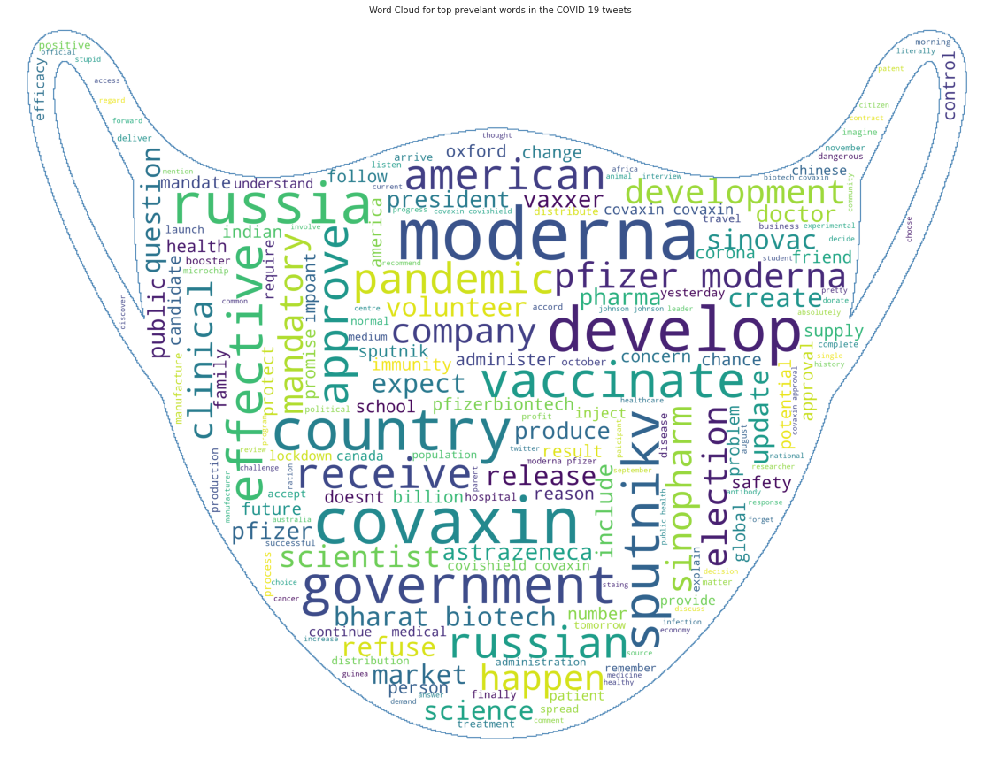

In [ ]:
tweets = twitter_df.tweet.tolist() 
tweets = ' '.join(tweets)
mask = np.array(Image.open('/resources/face_mask.png'))

word_cloud = WordCloud(
                    mask = mask,
                    contour_width=3, 
                    contour_color='steelblue',
                    background_color='white',
                    stopwords=stopwords_set,
                    max_font_size=60,
                    min_word_length=6,
                    scale=5,
                    random_state=1).generate(tweets)
fig = plt.figure(1, figsize=(20, 20))
plt.axis('off')
plt.title('Word Cloud for top prevelant words in the COVID-19 tweets', fontsize=10)
plt.imshow(word_cloud)
plt.show()

### 3.2 Using TextBlob

We perform sentiment analysis on the tweets using the TextBlob library. It uses a loop to iterate over each tweet in the twitter_df dataframe, calculates its polarity using TextBlob, and categorizes the tweet as either positive, negative, or neutral based on the polarity score.

In [ ]:
print("Sentiment analysis using TextBlob\n")
sentiment_df = pd.DataFrame()
for post in tqdm(twitter_df['tweet'], colour = "green"):
    polarity = TextBlob(post).sentiment.polarity
    if polarity < 0:
        sentiment = 'Negative'
    elif polarity == 0:
        sentiment = 'Neutral'
    else:
        sentiment = 'Positive'
    sentiment_df = pd.concat([sentiment_df, pd.DataFrame([(post, round(polarity, 2), sentiment)], columns=['Tweet', 'Tweet_Polarity', 'Tweet_Sentiment'])],
                             ignore_index=True)

sentiment_df.columns = ['Tweet', 'Tweet_Polarity', 'Tweet_Sentiment']
sentiment_df.to_csv(textblob_file_path)
display(sentiment_df.head(10))

Sentiment analysis using TextBlob



100%|██████████| 149359/149359 [08:57<00:00, 277.88it/s]


,Tweet,Tweet_Polarity,Tweet_Sentiment
0,world wrong side history year hopefully big va...,-0.25,Negative
1,fact immutable senator even ethically sturdy e...,0.10,Positive
2,many bright day best bidenharris win election,0.75,Positive
3,covid vaccine get covidvaccine covid pfizerbio...,0.00,Neutral
4,woman healthcare provider ask safety pfizerbio...,0.00,Neutral
5,update yellowfever covid immunitypasspos two s...,0.00,Neutral
6,coronavirus iran repos new case death last hou...,0.07,Positive
7,rake billion expensive covidvaccine refuse cut...,-0.50,Negative
8,trump announces vaccine rollout less hour firs...,0.03,Positive
9,food drug administration fda grant emergency u...,0.00,Neutral


### 3.3 Using VADER

For Vader, the polarity score for each tweet is calculated using a pre-trained sentiment lexicon and classified as Positive, Negative or Neutral based on the value of the compound score. The resulting dataframe contain the original tweet text, its polarity score, and its sentiment classification.

In [ ]:
print("Sentiment analysis using Vader\n")
sentiment_df_vader = pd.DataFrame()
for tweet in tqdm(twitter_df['tweet'], colour = "green"):
    sentiment_dict = SentimentIntensityAnalyzer().polarity_scores(tweet)
    if sentiment_dict['compound'] >= 0.05 :
        sentiment = "Positive"
    elif sentiment_dict['compound'] <= - 0.05 :
        sentiment = "Negative"
    else :
        sentiment = "Neutral"
    sentiment_df_vader = pd.concat([sentiment_df_vader, pd.DataFrame([(tweet, sentiment_dict['compound'], sentiment)], columns=['Tweet', 'Tweet_Polarity', 'Tweet_Sentiment'])],
                     ignore_index=True)

sentiment_df_vader.columns = ['Tweet', 'Tweet_Polarity', 'Tweet_Sentiment']
sentiment_df_vader.to_csv(vader_file_path)
sentiment_df_vader.head(10)

Sentiment analysis using Vader



100%|██████████| 149359/149359 [36:09<00:00, 68.84it/s]


,Tweet,Tweet_Polarity,Tweet_Sentiment
0,world wrong side history year hopefully big va...,-0.1027,Negative
1,fact immutable senator even ethically sturdy e...,0.0000,Neutral
2,many bright day best bidenharris win election,0.8979,Positive
3,covid vaccine get covidvaccine covid pfizerbio...,0.0000,Neutral
4,woman healthcare provider ask safety pfizerbio...,0.4215,Positive
5,update yellowfever covid immunitypasspos two s...,0.0000,Neutral
6,coronavirus iran repos new case death last hou...,-0.5994,Negative
7,rake billion expensive covidvaccine refuse cut...,-0.4215,Negative
8,trump announces vaccine rollout less hour firs...,0.0000,Neutral
9,food drug administration fda grant emergency u...,-0.0258,Neutral


### 3.4 Using RoBERTa

The code uses a pre-trained sentiment analysis model called "twitter-roberta-base-sentiment" to analyze the sentiment of tweets. It tokenizes the tweets using the Roberta tokenizer and converts them to PyTorch tensors. Then it passes each tensor through the Roberta model to obtain sentiment scores for the tweet, which are normalized using the softmax function. The results are stored in a Pandas dataframe that has columns for the original tweet and the corresponding sentiment scores for negative, neutral, and positive sentiments.

Running RoBERTa on our dataset needs high computing time. Hence the code has been commented out from the pipeline but the results are persisted in the outout folder.

In [ ]:
# roberta = "cardiffnlp/twitter-roberta-base-sentiment"
# roberta_model = AutoModelForSequenceClassification.from_pretrained(roberta)
# roberta_tokenizer = AutoTokenizer.from_pretrained(roberta)
# roberta_labels = ['Negative', 'Neutral', 'Positive']
# tweet_tensor_list = []
# for t in twitter_df['tweet'].tolist():
#   tweet_tensor_list.append(roberta_tokenizer(t, return_tensors='pt'))


# roberta_neg = []
# roberta_neu = []
# roberta_pos = []

# for tweet_tensor in tweet_tensor_list:
#   output = roberta_model(**tweet_tensor)
#   scores = output[0][0].detach().numpy()
#   scores = softmax(scores)
#   roberta_neg.append(scores[0])
#   roberta_neu.append(scores[1])
#   roberta_pos.append(scores[2])
#   roberta_results_dict = {'tweet': twitter_df['tweet'].tolist(), 'negative': roberta_neg, 'neutral': roberta_neu, 'positive': roberta_pos}
#   roberta_results_df = pd.DataFrame(roberta_results_dict)

# roberta_results_df.to_csv(roberta_file_path)
# roberta_results_df.head(10)

### 3.5 Comparing different sentiment analysers

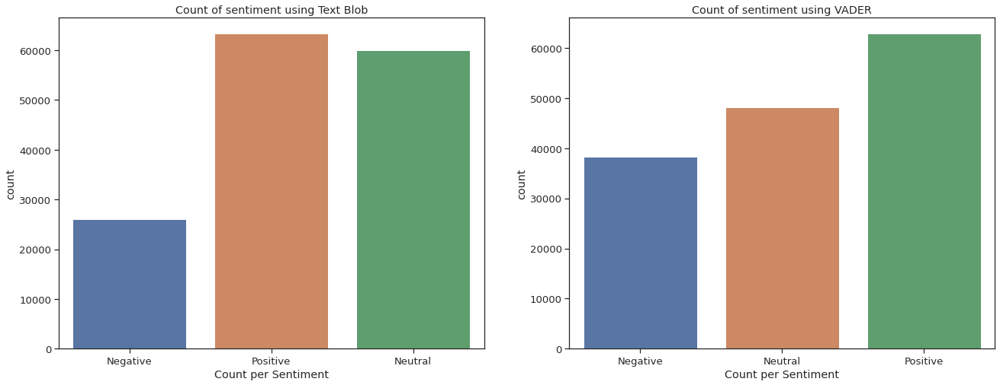

In [ ]:
fig = plt.figure(figsize=(22, 8))

fig.add_subplot(1, 2, 1)
sns.countplot(x='Tweet_Sentiment', data=sentiment_df, dodge=False)
plt.xlabel("Count per Sentiment")
plt.title("Count of sentiment using Text Blob")

fig.add_subplot(1, 2, 2)
sns.countplot(x='Tweet_Sentiment', data=sentiment_df_vader, dodge=False)
plt.xlabel("Count per Sentiment")
plt.title("Count of sentiment using VADER")

plt.show()

### 3.6 How has the sentiments varied over time?

In [ ]:
twitter_df= twitter_df.merge(sentiment_df_vader, left_on='tweet', right_on='Tweet')
twitter_df = twitter_df.drop(['Tweet'], axis=1)
twitter_df

,user_name,date,tweet,retweets_count,likes_count,replies_count,is_retweet,language,Tweet_Polarity,Tweet_Sentiment
0,Albert Fong,2020-12-13 16:27:13,world wrong side history year hopefully big va...,1.0,0.0,0.0,False,en,-0.1027,Negative
1,Charles Adler,2020-12-12 20:23:59,fact immutable senator even ethically sturdy e...,446.0,0.0,0.0,False,en,0.0000,Neutral
2,Dr.Krutika Kuppalli,2020-12-12 20:04:29,many bright day best bidenharris win election,2.0,0.0,0.0,False,en,0.8979,Positive
3,Erin Despas,2020-12-12 20:01:16,covid vaccine get covidvaccine covid pfizerbio...,2.0,0.0,0.0,False,en,0.0000,Neutral
4,Dr.Krutika Kuppalli,2020-12-12 17:19:02,woman healthcare provider ask safety pfizerbio...,48.0,0.0,0.0,False,en,0.4215,Positive
...,...,...,...,...,...,...,...,...,...,...
149354,gleaftus,2020-02-22 00:00:00,scientist discover condition call ade antibody...,1.0,1.0,0.0,False,en,0.3182,Positive
149355,zkusovac,2020-02-15 00:00:00,chance anti covid vaccine make soon anti kui w...,0.0,3.0,0.0,False,en,-0.3818,Negative
149356,yelisa888,2020-02-14 00:00:00,find vaccine coronavirus find covid covid vacc...,1.0,3.0,5.0,False,en,0.0000,Neutral
149357,denisonlab,2020-02-14 00:00:00,sho video coronavirus vaccine development effo...,5.0,13.0,0.0,False,en,0.0000,Neutral


The code adds a 'Month-Year' column to the 'twitter_df' dataset to get the number of sentiments across each category (positive, negative, neutral) for each month-year combination. It then creates new dataframes for positive, negative, and neutral sentiments by filtering the 'twitter_df' dataset based on the 'Tweet_Sentiment' column. 

In [ ]:
# Adding the Month-Year column to get the number of sentiments across each categories
twitter_df["month"] = twitter_df['date'].dt.month
twitter_df["year"] = twitter_df['date'].dt.year

cols = ['month', 'year']
twitter_df["Month_Year"] = twitter_df[cols].apply(lambda row: '/'.join(row.values.astype(str)), axis=1)

pos_df = twitter_df[twitter_df["Tweet_Sentiment"] == "Positive"]
neg_df = twitter_df[twitter_df["Tweet_Sentiment"] == "Negative"]
neu_df = twitter_df[twitter_df["Tweet_Sentiment"] == "Neutral"]

twitter_df = twitter_df.sort_values(['date'], ascending = [True])
twitter_df.head()

,user_name,date,tweet,retweets_count,likes_count,replies_count,is_retweet,language,Tweet_Polarity,Tweet_Sentiment,month,year,Month_Year
149358,p_anatacio,2020-02-12,guess month covid vaccine bad case scenario,0.0,1.0,0.0,False,en,-0.5423,Negative,2,2020,2/2020
149357,denisonlab,2020-02-14,sho video coronavirus vaccine development effo...,5.0,13.0,0.0,False,en,0.0000,Neutral,2,2020,2/2020
149356,yelisa888,2020-02-14,find vaccine coronavirus find covid covid vacc...,1.0,3.0,5.0,False,en,0.0000,Neutral,2,2020,2/2020
149355,zkusovac,2020-02-15,chance anti covid vaccine make soon anti kui w...,0.0,3.0,0.0,False,en,-0.3818,Negative,2,2020,2/2020
149354,gleaftus,2020-02-22,scientist discover condition call ade antibody...,1.0,1.0,0.0,False,en,0.3182,Positive,2,2020,2/2020


We create three dataframes for each sentiment category (positive, negative, and neutral) by counting the number of tweets in each category for each month-year combination. Then, it a new dataframe is created by merging the three sentiment dataframes with the count of total tweets per month-year combination.

In [ ]:
pos_df_num = pos_df.groupby(["Month_Year"], sort=False)['Tweet_Sentiment'].count()
pos_df_num = pos_df_num.reset_index()
pos_df_num = pos_df_num.rename(columns={"Tweet_Sentiment": 'Positive'})

neg_df_num = neg_df.groupby(["Month_Year"], sort=False)['Tweet_Sentiment'].count()
neg_df_num = neg_df_num.reset_index()
neg_df_num = neg_df_num.rename(columns={"Tweet_Sentiment": 'Negative'})

neu_df_num = neu_df.groupby(["Month_Year"], sort=False)['Tweet_Sentiment'].count()
neu_df_num = neu_df_num.reset_index()
neu_df_num = neu_df_num.rename(columns={"Tweet_Sentiment": 'Neutral'})

twitter_df_num = twitter_df.groupby(["Month_Year"], sort=False)["date"].count()
twitter_df_num = twitter_df_num.reset_index()

In [ ]:
twitter_df_num= twitter_df_num.merge(pos_df_num, left_on='Month_Year', right_on='Month_Year')
twitter_df_num= twitter_df_num.merge(neg_df_num, left_on='Month_Year', right_on='Month_Year')
twitter_df_num= twitter_df_num.merge(neu_df_num, left_on='Month_Year', right_on='Month_Year')
twitter_df_num = twitter_df_num.drop(['date'], axis=1)

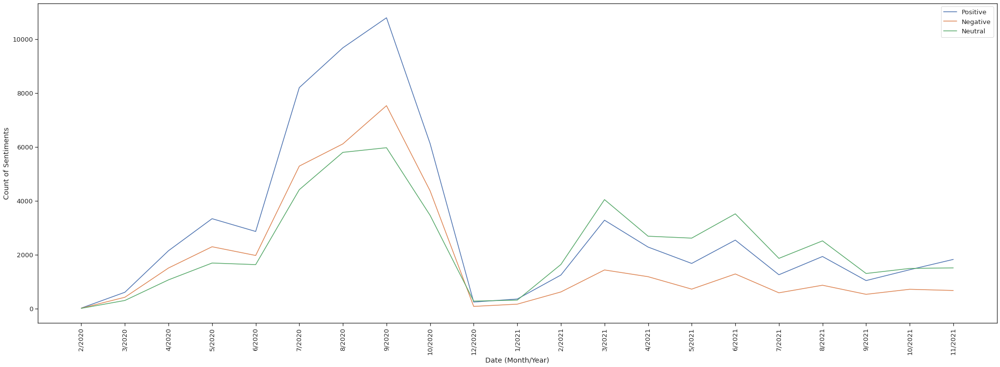

In [ ]:
plt.figure(figsize=(35, 12))

plt.plot(twitter_df_num["Month_Year"], twitter_df_num["Positive"], label = "Positive")
plt.plot(twitter_df_num["Month_Year"], twitter_df_num["Negative"], label = "Negative")
plt.plot(twitter_df_num["Month_Year"], twitter_df_num["Neutral"], label = "Neutral")
plt.xticks(rotation = 90)
plt.xlabel("Date (Month/Year)")
plt.ylabel("Count of Sentiments")
plt.legend()
plt.show()

### 3.7 What are the emotions observed?

We calculate the count of each emotion present in the tweets in the twitter_df dataset using the NRCLex library.

In [ ]:
str_tweet = ','.join(twitter_df['tweet'])
text_object = NRCLex(str_tweet)

In [ ]:
data = text_object.raw_emotion_scores

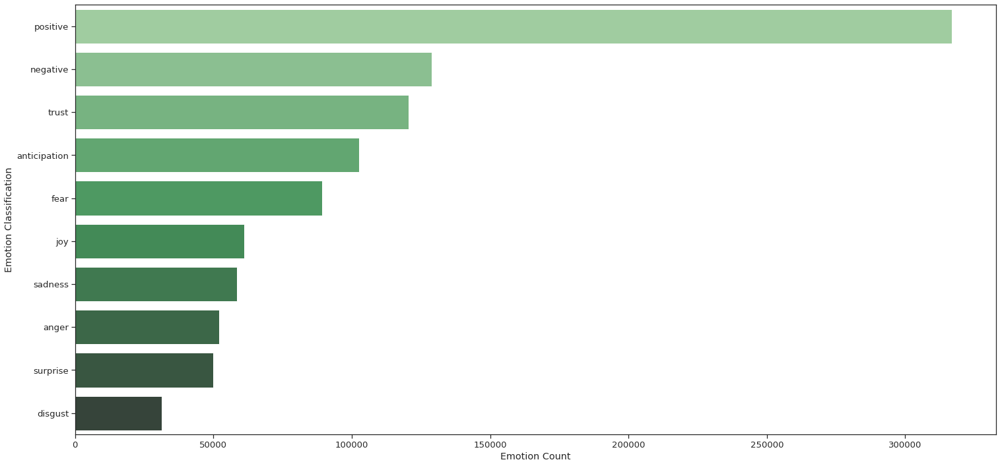

In [ ]:
emotion_df = pd.DataFrame.from_dict(data, orient='index')
emotion_df = emotion_df.reset_index()
emotion_df = emotion_df.rename(columns={'index' : 'Emotion Classification' , 0: 'Emotion Count'})
emotion_df = emotion_df.sort_values(by=['Emotion Count'], ascending=False)

plt.figure(figsize=(25, 12))
sns.barplot(data=emotion_df, x='Emotion Count', y='Emotion Classification',  orient='h', palette = 'Greens_d', color = 'b')
plt.show()

The code defines a function that receives a corpus, the number of top words to return and nGrams value (number of grams to consider in n-grams). It performs text preprocessing, removes stop words and returns the most frequent words based on the given n value. The top 10 most frequent 2-grams for positive, negative and neutral sentiments are plotted using Seaborn's barplot. The plot displays the frequency of the top words used in each sentiment category.

In [ ]:
def get_top_n_words(corpus, n=None, nGrams=1):
  vec = CountVectorizer(max_df=0.8,
                        stop_words=list(stopwords_set),
                        ngram_range=(nGrams,nGrams),
                        max_features=10000).fit(corpus)
  bag_of_words = vec.transform(corpus)
  sum_words = bag_of_words.sum(axis=0)
  words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
  words_freq = sorted(words_freq, key = lambda x: x[1], reverse=True)
  return words_freq[:n]

Text(0.5, 1.0, 'Most Frequently occuring words for each sentiment')

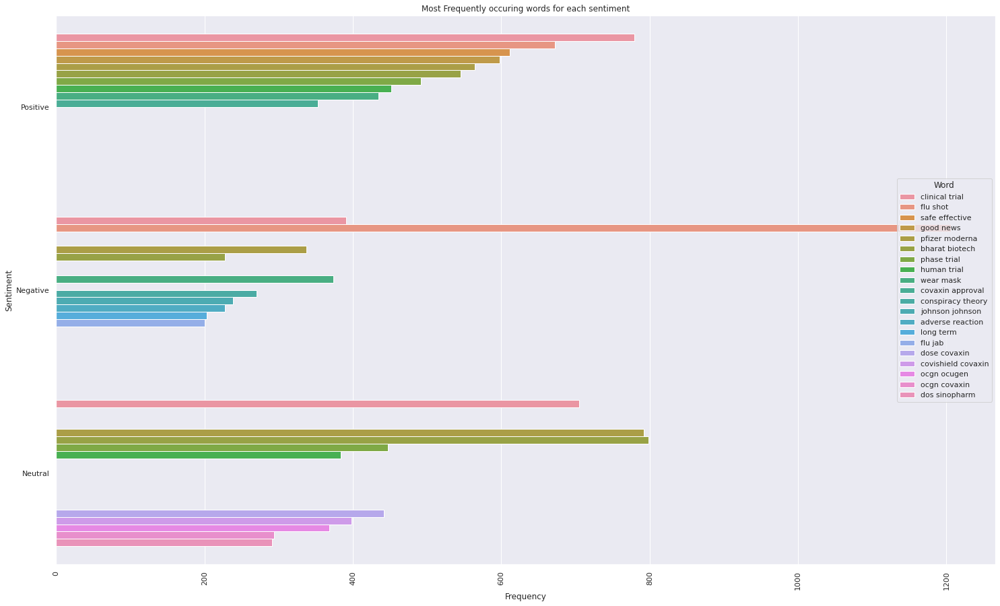

In [ ]:
# PLOT top 20 most frequently occuring UNI-GRAMS
pos_top_words = get_top_n_words(pos_df['tweet'], n=10, nGrams=2)
pos_top_df = pd.DataFrame(pos_top_words)
pos_top_df.columns=["Word", "Frequency"]
pos_top_df["Sentiment"]="Positive"

neg_top_words = get_top_n_words(neg_df['tweet'], n=10, nGrams=2)
neg_top_df = pd.DataFrame(neg_top_words)
neg_top_df.columns=["Word", "Frequency"]
neg_top_df["Sentiment"]="Negative"

neu_top_words = get_top_n_words(neu_df['tweet'], n=10, nGrams=2)
neu_top_df = pd.DataFrame(neu_top_words)
neu_top_df.columns=["Word", "Frequency"]
neu_top_df["Sentiment"]="Neutral"

fig = plt.figure(figsize=(25, 15))
mixed_df = pd.concat([pos_top_df, neg_top_df, neu_top_df], ignore_index=True)
sns.set(rc={'figure.figsize':(13,8)})
g = sns.barplot(data=mixed_df, x="Frequency", y="Sentiment", hue="Word")
g.set_xticklabels(g.get_xticklabels(), rotation=90)
plt.title("Most Frequently occuring words for each sentiment")

In [ ]:
twitter_df.to_csv(snt_analysis_file_path)

## 4. Topic Modeling

> This code performs topic modeling on a Twitter dataset using BERTopic. It creates embeddings of the tweets using BERT sentence embeddings and then applies HDBSCAN clustering to identify topics. The code also visualizes the topics over time and reduces outliers in the topic model. The resulting topics are added to the original Twitter dataset and saved as a CSV file.



In [ ]:
twitter_df = pd.read_csv(snt_analysis_file_path, encoding="ISO-8859-1")

In [ ]:
vectorizer_model = CountVectorizer(ngram_range=(1,2), stop_words = list(stopwords_set))

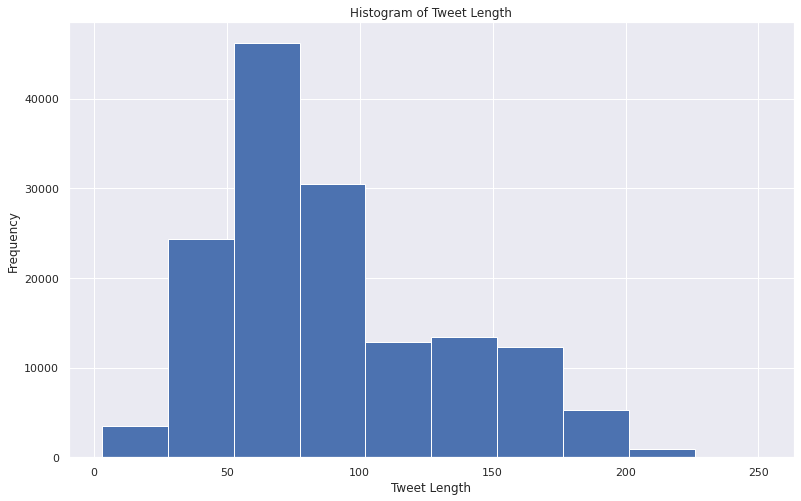

In [ ]:
twitter_df['tweet_length'] = twitter_df['tweet'].apply(len)
plt.hist(twitter_df['tweet_length'])
plt.xlabel('Tweet Length')
plt.ylabel('Frequency')
plt.title('Histogram of Tweet Length')
plt.show()

### 4.1 Creating embeddings & training BERT model

BERTopic library is being used to create topics for the tweets in the dataframe. The sentence_model is a pre-trained BERT model used to embed the tweets into vector representations. The embeddings are persisted to avoid recomputing them each time the code is run. The HDBSCAN algorithm is used to cluster the embedded tweets into groups, which are then used to create topics using the BERTopic algorithm.

In [ ]:
# Persisting the embeddings since recomputation takes time due to the sataset size
doc = twitter_df['tweet'].tolist()

if(os.path.isfile(embedding_file_path) == False):
  embeddings = sentence_model.encode(doc)
  np.save(embedding_file_path, embeddings)
else:
  embeddings = np.load(embedding_file_path)

In [ ]:
# Persisting the model since recomputation akes time due to the dataset size
if(os.path.isfile(model_file_path) == False):
  cluster_model = HDBSCAN(min_cluster_size=300, min_samples=5, metric='euclidean', prediction_data = True)
  topic_model = BERTopic(embedding_model=sentence_model, 
                         language='English', 
                         verbose=True,
                         calculate_probabilities=True, 
                         vectorizer_model = vectorizer_model, 
                         n_gram_range=(1,2), 
                         min_topic_size = 100, 
                         hdbscan_model=cluster_model)
  topic_model.save(model_file_path)
else:
  topic_model = BERTopic.load(model_file_path)

topic, probs = topic_model.fit_transform(doc, embeddings)

### 4.2 Visualizing relevant topics across each sentiment class

We visualize the topics per sentiment class, topics over time, frequency and information of selected topics, and also generates visualizations like documents visualization, reduced dimensionality visualization, heatmap, hierarchy, barchart, and topics.

In [ ]:
classes = ['Negative','Positive','Neutral']
topics_per_class = topic_model.topics_per_class(doc, classes=twitter_df['Tweet_Sentiment'])
topics_per_class

3it [00:06,  2.29s/it]


,Topic,Words,Frequency,Class
0,-1,"trial, death, die, work, covaxin",14091,Negative
1,0,"mrna, pay, money, stock, company",2019,Negative
2,1,"shit, wait, fear, hell, damn",1436,Negative
3,2,"india, icmr, indian, serum, exam",808,Negative
4,3,"trump, election, fda, president, american",1674,Negative
...,...,...,...,...
238,75,"drug, bharat, bharat biotech, expe, biotech",142,Positive
239,76,"japan, japanese, contamination, moderna, moder...",39,Positive
240,77,"booster, moderna booster, booster shot, modern...",115,Positive
241,78,"album, music, song, sing, tour",137,Positive


In [ ]:
topics_per_class.to_csv(relevant_topics , index=False)

In [ ]:
topic_model.visualize_topics_per_class(topics_per_class, top_n_topics=10, topics=[2,10,12,19,21,27,29,22,5,16])

### 4.3 Reducing embedding dimensionality & more visualizations

We visualize a topic model using two sets of embeddings. The first visualization uses the original embeddings and the second visualization uses the embeddings reduced in dimensionality using the UMAP algorithm. The second visualization focuses only on certain topics rather than all topics.

In [ ]:
# Run the visualization with the original embeddings
topic_model.visualize_documents(doc, embeddings=embeddings)

In [ ]:
# Reduce dimensionality of embeddings, this step is optional but much faster to perform iteratively:
reduced_embeddings = UMAP(n_neighbors=10, n_components=2, min_dist=0.0, metric='cosine').fit_transform(embeddings)
topic_model.visualize_documents(doc, reduced_embeddings=reduced_embeddings, topics=[2,10,12,19,21,27,29,22,5,16])

In [ ]:
timestamps = twitter_df['Month_Year'].to_list()
topics_over_time = topic_model.topics_over_time(doc, timestamps)
topic_model.visualize_topics_over_time(topics_over_time, topics=[2,10,12,19,21,27,29,22,5,16])

21it [03:30, 10.04s/it]


In [ ]:
topic_freq = topic_model.get_topic_freq()
display(topic_freq[topic_freq["Topic"].isin([2,10,12,19,21,27,29,22,5,16])])

,Topic,Count
3,2,4713
6,5,3475
11,10,2154
13,12,1995
17,16,1554
20,19,1435
22,21,1199
23,22,1154
28,27,871
30,29,842


In [ ]:
topic_info = topic_model.get_topic_info()
display(topic_info[topic_info["Topic"].isin([2,10,12,19,21,27,29,22,5,16])])

,Topic,Count,Name
3,2,4713,2_india_indian_serum_icmr
6,5,3475,5_covaxin_covishield_india_dose
11,10,2154,10_covaxin_approval_covaxin approval_phase
13,12,1995,12_mask_wear_wear mask_face mask
17,16,1554,16_sputnikv_sputnik_russia_russian
20,19,1435,19_sputnikv_sputnik_russia_slovakia
22,21,1199,21_moderna_moderna moderna_dose moderna_dose
23,22,1154,22_ocgn_ocugen_ocgn covaxin_covaxin
28,27,871,27_bharat_covaxin_bharat biotech_biotech
30,29,842,29_astrazeneca_oxford_trial_oxford astrazeneca


In [ ]:
topic_model.visualize_heatmap()

In [ ]:
topic_model.visualize_hierarchy()

In [ ]:
topic_model.visualize_barchart()

In [ ]:
topic_model.visualize_topics()

In [ ]:
# Reducing outliers
new_topics = topic_model.reduce_outliers(doc, topic)

twitter_df['topic'] = new_topics
twitter_df.to_csv(topic_op_file_path, index=False)

100%|██████████| 55/55 [00:08<00:00,  6.48it/s]


## 5. Named Entity Recognition



> The code performs Named Entity Recognition (NER) on the tweets present in the dataframe "twitter_df" using spaCy's NLP model. It extracts entities of types PERSON, NORP, ORG, and GPE, and stores them in separate columns named Person, Norp, Org, and Gpe respectively. Finally, it saves the updated dataframe to a CSV file.

In [ ]:
persons = []
norps = []
orgs = []
gpes = []
for r in tqdm(list(twitter_df['tweet'])):
    person = []
    norp = []
    org = []
    gpe = []
 
    doc = spacy_nlp(r)
    for e in doc.ents:
        if e.label_=='PERSON':
            person.append(e.text)
        if e.label_=='NORP':
            norp.append(e.text)
        if e.label_=='ORG':
            org.append(e.text)
        if e.label_=='GPE':
            gpe.append(e.text)

    persons.append("-".join(person))
    norps.append("-".join(norp))
    orgs.append("-".join(org))
    gpes.append("-".join(gpe))
    displacy.render(doc, style='ent', jupyter=True, options={'distance' : 90})


twitter_df["Person"] = persons
twitter_df["Norp"] = norps
twitter_df["Org"] = orgs
twitter_df["Gpe"] = gpes

twitter_df.to_csv(ner_op_file_path, index=False)
twitter_df.head()

  0%|          | 0/149359 [00:00<?, ?it/s]

  0%|          | 1/149359 [00:00<7:05:41,  5.85it/s]

  0%|          | 8/149359 [00:00<1:13:42, 33.77it/s]

  0%|          | 15/149359 [00:00<52:10, 47.70it/s] 

  0%|          | 22/149359 [00:00<45:26, 54.76it/s]

  0%|          | 29/149359 [00:00<42:27, 58.61it/s]

  0%|          | 36/149359 [00:00<41:24, 60.09it/s]

  0%|          | 43/149359 [00:00<39:59, 62.23it/s]

  0%|          | 50/149359 [00:00<39:32, 62.93it/s]

  0%|          | 57/149359 [00:01<41:01, 60.66it/s]

  0%|          | 64/149359 [00:01<40:31, 61.39it/s]

  0%|          | 72/149359 [00:01<38:02, 65.40it/s]

  0%|          | 79/149359 [00:01<37:18, 66.67it/s]

  0%|          | 86/149359 [00:01<36:53, 67.43it/s]

  0%|          | 94/149359 [00:01<35:42, 69.65it/s]

  0%|          | 101/149359 [00:01<37:29, 66.36it/s]

  0%|          | 108/149359 [00:01<37:24, 66.50it/s]

  0%|          | 116/149359 [00:01<35:52, 69.34it/s]

  0%|          | 123/149359 [00:01<36:09, 68.78it/s]

  0%|          | 130/149359 [00:02<38:01, 65.41it/s]

  0%|          | 137/149359 [00:02<37:38, 66.07it/s]

  0%|          | 144/149359 [00:02<37:03, 67.11it/s]

  0%|          | 151/149359 [00:02<37:19, 66.64it/s]

  0%|          | 159/149359 [00:02<36:10, 68.75it/s]

  0%|          | 166/149359 [00:02<37:17, 66.68it/s]

  0%|          | 174/149359 [00:02<36:07, 68.83it/s]

  0%|          | 181/149359 [00:02<36:01, 69.01it/s]

  0%|          | 188/149359 [00:02<37:26, 66.39it/s]

  0%|          | 195/149359 [00:03<38:05, 65.27it/s]

  0%|          | 203/149359 [00:03<36:37, 67.87it/s]

  0%|          | 210/149359 [00:03<37:18, 66.63it/s]

  0%|          | 217/149359 [00:03<38:45, 64.14it/s]

  0%|          | 224/149359 [00:03<38:36, 64.37it/s]

  0%|          | 231/149359 [00:03<38:30, 64.54it/s]

  0%|          | 238/149359 [00:03<38:21, 64.80it/s]

  0%|          | 245/149359 [00:03<39:43, 62.55it/s]

  0%|          | 252/149359 [00:03<40:47, 60.93it/s]

  0%|          | 259/149359 [00:04<39:28, 62.95it/s]

  0%|          | 266/149359 [00:04<39:07, 63.52it/s]

  0%|          | 274/149359 [00:04<37:39, 65.98it/s]

  0%|          | 282/149359 [00:04<36:37, 67.85it/s]

  0%|          | 289/149359 [00:04<37:15, 66.69it/s]

  0%|          | 296/149359 [00:04<38:57, 63.77it/s]

  0%|          | 303/149359 [00:04<38:39, 64.26it/s]

  0%|          | 310/149359 [00:04<38:44, 64.11it/s]

  0%|          | 318/149359 [00:04<37:09, 66.85it/s]

  0%|          | 325/149359 [00:05<36:47, 67.52it/s]

  0%|          | 332/149359 [00:05<38:14, 64.96it/s]

  0%|          | 339/149359 [00:05<42:41, 58.17it/s]

  0%|          | 346/149359 [00:05<42:09, 58.92it/s]

  0%|          | 352/149359 [00:05<43:39, 56.87it/s]

  0%|          | 358/149359 [00:05<43:48, 56.68it/s]

  0%|          | 365/149359 [00:05<41:32, 59.77it/s]

  0%|          | 373/149359 [00:05<39:09, 63.40it/s]

  0%|          | 380/149359 [00:06<42:28, 58.46it/s]

  0%|          | 387/149359 [00:06<42:05, 59.00it/s]

  0%|          | 393/149359 [00:06<45:50, 54.15it/s]

  0%|          | 399/149359 [00:06<46:24, 53.49it/s]

  0%|          | 405/149359 [00:06<46:05, 53.86it/s]

  0%|          | 411/149359 [00:06<47:19, 52.45it/s]

  0%|          | 417/149359 [00:06<49:04, 50.58it/s]

  0%|          | 423/149359 [00:06<47:32, 52.21it/s]

  0%|          | 430/149359 [00:06<44:45, 55.45it/s]

  0%|          | 436/149359 [00:07<45:15, 54.84it/s]

  0%|          | 442/149359 [00:07<44:56, 55.23it/s]

  0%|          | 449/149359 [00:07<43:51, 56.59it/s]

  0%|          | 456/149359 [00:07<42:15, 58.72it/s]

  0%|          | 462/149359 [00:07<42:03, 59.01it/s]

  0%|          | 470/149359 [00:07<38:47, 63.96it/s]

  0%|          | 477/149359 [00:07<40:13, 61.69it/s]

  0%|          | 484/149359 [00:07<38:59, 63.65it/s]

  0%|          | 492/149359 [00:07<37:23, 66.35it/s]

  0%|          | 499/149359 [00:08<37:55, 65.42it/s]

  0%|          | 506/149359 [00:08<40:46, 60.85it/s]

  0%|          | 513/149359 [00:08<41:06, 60.34it/s]

  0%|          | 520/149359 [00:08<42:51, 57.88it/s]

  0%|          | 527/149359 [00:08<41:06, 60.34it/s]

  0%|          | 535/149359 [00:08<38:33, 64.33it/s]

  0%|          | 543/149359 [00:08<37:06, 66.84it/s]

  0%|          | 550/149359 [00:08<37:04, 66.90it/s]

  0%|          | 557/149359 [00:09<38:42, 64.08it/s]

  0%|          | 564/149359 [00:09<37:49, 65.56it/s]

  0%|          | 571/149359 [00:09<39:22, 62.98it/s]

  0%|          | 578/149359 [00:09<38:40, 64.11it/s]

  0%|          | 586/149359 [00:09<36:12, 68.48it/s]

  0%|          | 593/149359 [00:09<37:40, 65.80it/s]

  0%|          | 602/149359 [00:09<34:34, 71.69it/s]

  0%|          | 610/149359 [00:09<33:43, 73.52it/s]

  0%|          | 618/149359 [00:09<37:27, 66.17it/s]

  0%|          | 625/149359 [00:10<37:08, 66.74it/s]

  0%|          | 633/149359 [00:10<36:16, 68.33it/s]

  0%|          | 640/149359 [00:10<40:21, 61.41it/s]

  0%|          | 648/149359 [00:10<39:12, 63.20it/s]

  0%|          | 655/149359 [00:10<40:41, 60.90it/s]

  0%|          | 662/149359 [00:10<39:28, 62.78it/s]

  0%|          | 670/149359 [00:10<37:54, 65.36it/s]

  0%|          | 677/149359 [00:10<37:12, 66.59it/s]

  0%|          | 684/149359 [00:10<37:12, 66.59it/s]

  0%|          | 693/149359 [00:11<34:39, 71.48it/s]

  0%|          | 701/149359 [00:11<35:00, 70.76it/s]

  0%|          | 709/149359 [00:11<36:10, 68.49it/s]

  0%|          | 716/149359 [00:11<37:58, 65.24it/s]

  0%|          | 723/149359 [00:11<39:03, 63.44it/s]

  0%|          | 730/149359 [00:11<42:27, 58.34it/s]

  0%|          | 736/149359 [00:11<42:16, 58.60it/s]

  0%|          | 743/149359 [00:11<41:05, 60.28it/s]

  1%|          | 750/149359 [00:12<42:35, 58.16it/s]

  1%|          | 756/149359 [00:12<43:28, 56.97it/s]

  1%|          | 762/149359 [00:12<43:14, 57.27it/s]

  1%|          | 768/149359 [00:12<44:53, 55.17it/s]

  1%|          | 774/149359 [00:12<47:07, 52.55it/s]

  1%|          | 780/149359 [00:12<47:45, 51.85it/s]

  1%|          | 786/149359 [00:12<47:32, 52.08it/s]

  1%|          | 792/149359 [00:12<46:08, 53.65it/s]

  1%|          | 798/149359 [00:12<45:59, 53.83it/s]

  1%|          | 805/149359 [00:13<43:21, 57.11it/s]

  1%|          | 812/149359 [00:13<42:15, 58.58it/s]

  1%|          | 819/149359 [00:13<41:48, 59.21it/s]

  1%|          | 826/149359 [00:13<41:23, 59.81it/s]

  1%|          | 832/149359 [00:13<42:06, 58.80it/s]

  1%|          | 838/149359 [00:13<42:52, 57.73it/s]

  1%|          | 844/149359 [00:13<42:32, 58.18it/s]

  1%|          | 851/149359 [00:13<41:57, 58.98it/s]

  1%|          | 859/149359 [00:13<39:09, 63.20it/s]

  1%|          | 866/149359 [00:14<40:02, 61.80it/s]

  1%|          | 873/149359 [00:14<40:10, 61.60it/s]

  1%|          | 880/149359 [00:14<40:52, 60.54it/s]

  1%|          | 887/149359 [00:14<39:45, 62.25it/s]

  1%|          | 894/149359 [00:14<39:28, 62.69it/s]

  1%|          | 901/149359 [00:14<39:57, 61.91it/s]

  1%|          | 908/149359 [00:14<39:51, 62.09it/s]

  1%|          | 915/149359 [00:14<39:28, 62.68it/s]

  1%|          | 922/149359 [00:14<40:50, 60.57it/s]

  1%|          | 929/149359 [00:15<39:33, 62.53it/s]

  1%|          | 936/149359 [00:15<39:17, 62.96it/s]

  1%|          | 943/149359 [00:15<38:16, 64.63it/s]

  1%|          | 950/149359 [00:15<38:05, 64.93it/s]

  1%|          | 958/149359 [00:15<37:36, 65.77it/s]

  1%|          | 965/149359 [00:15<38:00, 65.08it/s]

  1%|          | 973/149359 [00:15<36:41, 67.41it/s]

  1%|          | 981/149359 [00:15<35:41, 69.29it/s]

  1%|          | 988/149359 [00:15<36:33, 67.63it/s]

  1%|          | 996/149359 [00:16<36:01, 68.63it/s]

  1%|          | 1003/149359 [00:16<35:57, 68.78it/s]

  1%|          | 1011/149359 [00:16<34:41, 71.25it/s]

  1%|          | 1019/149359 [00:16<33:51, 73.03it/s]

  1%|          | 1027/149359 [00:16<33:16, 74.31it/s]

  1%|          | 1035/149359 [00:16<32:50, 75.28it/s]

  1%|          | 1044/149359 [00:16<32:08, 76.92it/s]

  1%|          | 1052/149359 [00:16<33:28, 73.86it/s]

  1%|          | 1060/149359 [00:16<35:55, 68.80it/s]

  1%|          | 1067/149359 [00:17<35:54, 68.84it/s]

  1%|          | 1074/149359 [00:17<36:58, 66.84it/s]

  1%|          | 1082/149359 [00:17<35:36, 69.39it/s]

  1%|          | 1090/149359 [00:17<34:18, 72.03it/s]

  1%|          | 1099/149359 [00:17<33:02, 74.78it/s]

  1%|          | 1107/149359 [00:17<35:13, 70.13it/s]

  1%|          | 1115/149359 [00:17<36:59, 66.80it/s]

  1%|          | 1123/149359 [00:17<36:02, 68.56it/s]

  1%|          | 1131/149359 [00:17<35:12, 70.17it/s]

  1%|          | 1139/149359 [00:18<34:43, 71.15it/s]

  1%|          | 1147/149359 [00:18<34:47, 71.01it/s]

  1%|          | 1155/149359 [00:18<35:22, 69.82it/s]

  1%|          | 1163/149359 [00:18<34:50, 70.88it/s]

  1%|          | 1171/149359 [00:18<34:54, 70.77it/s]

  1%|          | 1179/149359 [00:18<35:17, 69.99it/s]

  1%|          | 1187/149359 [00:18<36:22, 67.88it/s]

  1%|          | 1194/149359 [00:18<38:19, 64.42it/s]